In [17]:
# Imports, path setup

import os
from pathlib import Path
import pandas as pd
import matplotlib.pyplot as plt
import rasterio
import numpy as np

import rvt.vis
import rvt.blend
import rvt.default

# Set working directories
CWD = os.getcwd()
DTM_DIRS = {
    "A": os.path.join(CWD, "data", "processed", "dtm", "fnands_openai_optimised_02"),
    "B": os.path.join(CWD, "data", "processed", "dtm", "fnands_openai_optimised_04"),
}
VAT_DIR = os.path.join(CWD, "data", "processed", "vat")  # Lowercase 'vat' to match your directory
METAFILE = os.path.join(CWD, "prefix7_metafile.txt")

PIPELINE_SUFFIX = {
    "A": "_fnands_openai_optimised_02.tif",
    "B": "_fnands_openai_optimised_04.tif"
}

# a = list(DTM_DIRS.values())[:]
# for dir in [a[0], a[1], VAT_DIR]:
#     print(f"{dir}: {os.path.isdir(dir)}")

# print(f"{METAFILE} :{os.path.exists(METAFILE)}")

In [18]:
# Read list of filenames (stripping off '.laz' if present)
with open(METAFILE, "r") as f:
    laz_basenames = [Path(line.strip()).stem for line in f if line.strip()]

print(f"Found {len(laz_basenames)} filenames in metafile.")
if len(laz_basenames) == 0:
    raise RuntimeError("No filenames found in metafile.")

Found 74 filenames in metafile.


In [19]:
# Block 2: Load metadata CSV
METADATA_CSV = os.path.join(CWD, "lidar_metadata_full.csv")
metadata_df = pd.read_csv(METADATA_CSV)

In [20]:
def compute_combined_vat(input_dem_path, output_vat_path, general_opacity, 
                         vat_comb_json, terrain_sett_json, normalize=False):
    """Compute and save VAT Combined float for a single DTM."""
    if os.path.isfile(output_vat_path):
        print(f"{output_vat_path} already exists. Skipping computation.")
        return output_vat_path

    default_1 = rvt.default.DefaultValues()
    default_2 = rvt.default.DefaultValues()
    default_1.fill_no_data = 0
    default_2.fill_no_data = 0
    default_1.keep_original_no_data = 0
    default_2.keep_original_no_data = 0

    vat_comb_1 = rvt.blend.BlenderCombination()
    vat_comb_2 = rvt.blend.BlenderCombination()
    vat_comb_1.read_from_file(vat_comb_json)
    vat_comb_2.read_from_file(vat_comb_json)
    
    terrain_settings = rvt.blend.TerrainsSettings()
    terrain_settings.read_from_file(terrain_sett_json)
    terrain_1 = terrain_settings.select_terrain_settings_by_name("general")
    terrain_2 = terrain_settings.select_terrain_settings_by_name("flat")
    terrain_1.apply_terrain(default=default_1, combination=vat_comb_1)
    terrain_2.apply_terrain(default=default_2, combination=vat_comb_2)
    
    #####
    dict_arr_res_nd = rvt.default.get_raster_arr(raster_path=input_dem_path)

    if normalize:
        # Prepare normalized DTM
        dtm = dict_arr_res_nd["array"].astype(float)
        finite = dtm[np.isfinite(dtm)]
        lower, upper = np.percentile(finite, [2, 98])
        dtm = np.clip(dtm, lower, upper)
        dtm = (dtm - lower) / (upper - lower)
        # preserve nodata
        if "no_data" in dict_arr_res_nd and dict_arr_res_nd["no_data"] is not None:
            dtm[dict_arr_res_nd["array"] == dict_arr_res_nd["no_data"]] = np.nan
        dem_to_use = dtm
        print(f"Applied percentile normalization ({lower:.2f} - {upper:.2f}) to DTM: {input_dem_path}")
    else:
        # Use the raw DTM array
        dem_to_use = dict_arr_res_nd["array"]

    vat_comb_1.add_dem_arr(dem_arr=dem_to_use, dem_resolution=dict_arr_res_nd["resolution"][0])
    vat_arr_1 = vat_comb_1.render_all_images(default=default_1, no_data=dict_arr_res_nd["no_data"])
    vat_comb_2.add_dem_arr(dem_arr=dem_to_use, dem_resolution=dict_arr_res_nd["resolution"][0])
    vat_arr_2 = vat_comb_2.render_all_images(default=default_2, no_data=dict_arr_res_nd["no_data"])
    #####

    combination = rvt.blend.BlenderCombination()
    combination.create_layer(
        vis_method="VAT general", image=vat_arr_1, normalization="Value",
        minimum=0, maximum=1, blend_mode="Normal", opacity=general_opacity
    )
    combination.create_layer(
        vis_method="VAT flat", image=vat_arr_2, normalization="Value",
        minimum=0, maximum=1, blend_mode="Normal", opacity=100
    )
    combination.add_dem_path(dem_path=input_dem_path)
    combination.render_all_images(
        save_render_path=output_vat_path, save_visualizations=False, 
        save_float=True, save_8bit=False,
        no_data=dict_arr_res_nd["no_data"]
    )
    print(f"VAT Combined saved to {output_vat_path}")
    return output_vat_path

In [21]:
# Block 4: Visualisation function

# Utility: read vat raster as float (with np.nan for nodata)
def read_vat_float_image(vat_path):
    with rasterio.open(vat_path) as src:
        arr = src.read(1).astype(float)
        # Replace nodata by np.nan
        no_data = src.nodatavals[0]
        if no_data is not None:
            arr[arr == no_data] = np.nan
        return arr
    
def plot_vat_pair_with_density(
    fname, 
    dtm_dirs=DTM_DIRS, 
    suffix=PIPELINE_SUFFIX, 
    vat_dir=VAT_DIR, 
    metadata_df=metadata_df, 
    show_titles=True
):
    """Show A/B VATs for fname, with density annotation."""
    # DTM and VAT paths
    dtm_paths = {}
    vat_paths = {}
    for label in ["A", "B"]:
        dtm_fname = f"{fname}{suffix[label]}"
        dtm_path = os.path.join(dtm_dirs[label], dtm_fname)
        dtm_paths[label] = dtm_path
        vat_fname = dtm_fname.replace(".tif", "_VAT_Combined.tif")
        vat_path = os.path.join(vat_dir, vat_fname)
        vat_paths[label] = vat_path

    # Get ground point density
    csv_name = f"{fname}.laz"
    row = metadata_df[metadata_df['filename'] == csv_name]
    if row.empty:
        ground_density = None
    else:
        ground_density = float(row.iloc[0]['density_ground_per_m2'])

    # Read images
    for label in ["A", "B"]:
        if not os.path.isfile(vat_paths[label]):
            print(f"ERROR: Missing VAT file for {label}: {vat_paths[label]}")
            return
    vat_a = read_vat_float_image(vat_paths["A"])
    vat_b = read_vat_float_image(vat_paths["B"])

    # Display
    fig, axes = plt.subplots(1, 2, figsize=(16, 8))
    vmin = np.nanmin([vat_a, vat_b])
    vmax = np.nanmax([vat_a, vat_b])
    titles = [
        f"{fname} | pipeline A | density_ground_per_m2={ground_density:.3f}" if ground_density is not None else f"{fname} | pipeline A",
        f"{fname} | pipeline B | density_ground_per_m2={ground_density:.3f}" if ground_density is not None else f"{fname} | pipeline B"
    ]
    for i, (arr, ax) in enumerate(zip([vat_a, vat_b], axes)):
        im = ax.imshow(arr, cmap='gray', vmin=vmin, vmax=vmax)
        if show_titles:
            ax.set_title(titles[i], fontsize=14)
        ax.axis('off')

    plt.tight_layout()
    plt.show()

In [50]:
def process_and_plot_vat_pair_by_index(
    index,
    laz_basenames=laz_basenames,
    dtm_dirs=DTM_DIRS,
    pipeline_suffix=PIPELINE_SUFFIX,
    vat_dir=VAT_DIR,
    general_opacity=GENERAL_OPACITY,
    vat_comb_json=VAT_COMB_JSON,
    terrain_sett_json=TERRAIN_SETT_JSON,
    metadata_df=metadata_df):
    """
    For a given index in laz_basenames:
      - Ensure both A and B VAT Combined images are generated (if needed)
      - Then plot as a side-by-side panel with ground density
    """
    if index >= len(laz_basenames) or index < 0:
        print(f"ERROR: Index {index} out of range.")
        return
    fname = laz_basenames[index]
    # Prepare DTM and VAT paths
    dtm_paths = {}
    vat_paths = {}
    for label in ['A', 'B']:
        dtm_fname = f"{fname}{pipeline_suffix[label]}"
        dtm_path = os.path.join(dtm_dirs[label], dtm_fname)
        vat_fname = dtm_fname.replace('.tif', '_VAT_Combined.tif')
        vat_path = os.path.join(vat_dir, vat_fname)
        dtm_paths[label] = dtm_path
        vat_paths[label] = vat_path

    # Create VAT if missing (for both)
    for label in ['A', 'B']:
        if not os.path.isfile(vat_paths[label]):
            if os.path.isfile(dtm_paths[label]):
                print(f"Computing VAT Combined for {fname} [{label}] ...")
                compute_combined_vat(
                    input_dem_path=dtm_paths[label],
                    output_vat_path=vat_paths[label],
                    general_opacity=general_opacity,
                    vat_comb_json=vat_comb_json,
                    terrain_sett_json=terrain_sett_json)
            else:
                print(f"ERROR: DTM missing for {fname} [{label}]: {dtm_paths[label]}")
    # Plot (if possible)
    # plot_vat_pair_with_density(fname,
    #                           dtm_dirs=dtm_dirs,
    #                           suffix=pipeline_suffix,
    #                           vat_dir=vat_dir,
    #                           metadata_df=metadata_df)



In [51]:
index = -1

In [97]:
# Example usage – step through with:
index +=1  # or whatever index you want
for index in range(100):
    print(index)
    process_and_plot_vat_pair_by_index(index)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
ERROR: DTM missing for cms_brazil_lidar_tile_inventory [A]: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/dtm/fnands_openai_optimised_02/cms_brazil_lidar_tile_inventory_fnands_openai_optimised_02.tif
ERROR: DTM missing for cms_brazil_lidar_tile_inventory [B]: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/dtm/fnands_openai_optimised_04/cms_brazil_lidar_tile_inventory_fnands_openai_optimised_04.tif
68
69
70
71
72
73
74
ERROR: Index 74 out of range.
75
ERROR: Index 75 out of range.
76
ERROR: Index 76 out of range.
77
ERROR: Index 77 out of range.
78
ERROR: Index 78 out of range.
79
ERROR: Index 79 out of range.
80
ERROR: Index 80 out of range.
81
ERROR: Index 81 out of range.
82
ERROR: Index 82 out of range.
83
ERROR: Index 83 out of range.
84
ERROR: Index 84 out

In [ ]:
bb

In [28]:
# --- Example usage for just the first file:
index += 1
print(index)
first_fname = laz_basenames[index]
plot_vat_pair_with_density(first_fname)

3
ERROR: Missing VAT file for A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/vat/FST_A04_2014_laz_11_fnands_openai_optimised_02_VAT_Combined.tif


In [15]:
# Block 5A: Process all VAT Combined float GeoTIFFs

all_ground_densities = {}

for fname in laz_basenames:
    # Prepare DTM and VAT paths for both pipelines
    dtm_files = {
        label: os.path.join(DTM_DIR, f"{fname}{suffix}")
        for label, suffix in PIPELINE_SUFFIX.items()
    }
    vat_files = {}
    exist_A = os.path.isfile(dtm_files["A"])
    exist_B = os.path.isfile(dtm_files["B"])
    if not exist_A or not exist_B:
        print(f"SKIP: Missing DTM for {fname}: "
              f"{'[A]' if not exist_A else ''} {'[B]' if not exist_B else ''}")
        continue

    for label in ['A', 'B']:
        dtm_fname = os.path.basename(dtm_files[label])
        vat_fname = dtm_fname.replace('.tif', '_VAT_Combined.tif')
        vat_path = os.path.join(VAT_DIR, vat_fname)
        vat_files[label] = vat_path
        # Make sure output dir exists
        os.makedirs(VAT_DIR, exist_ok=True)
        # Compute (skip if already exists)
        compute_combined_vat(
            input_dem_path=dtm_files[label],
            output_vat_path=vat_path,
            general_opacity=GENERAL_OPACITY,
            vat_comb_json=VAT_COMB_JSON,
            terrain_sett_json=TERRAIN_SETT_JSON
        )

    # Extract ground density for each file, store for visualization
    laz_name = f"{fname}.laz"
    row = metadata_df[metadata_df['filename'] == laz_name]
    if row.empty:
        print(f"WARNING: No metadata entry found for {laz_name}")
        ground_density = None
    else:
        ground_density = float(row.iloc[0]['density_ground_per_m2'])
    all_ground_densities[fname] = ground_density

/Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/JAM_A02_2011_laz_4_fnands_openai_optimised_02_VAT_Combined.tif already exists. Skipping computation.
/Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/JAM_A02_2011_laz_4_fnands_openai_optimised_04_VAT_Combined.tif already exists. Skipping computation.
SKIP: Missing DTM for BA3_A02_2014_laz_8: [A] 
SKIP: Missing DTM for TAP_A01_2012_laz_2: [A] 
SKIP: Missing DTM for FST_A04_2014_laz_11: [A] 
SKIP: Missing DTM for PRG_A01_2013_P09b_laz_7: [A] 
SKIP: Missing DTM for ST1_A01_2013_laz_51: [A] 
VAT Combined saved to /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/RIB_A01_2018_LAS_17_fnands_openai_optimised_02_VAT_Combined.tif
VAT Combined saved to /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/RIB_A01_2018_LAS_17_fnands_openai_optimised_04_VAT_Combined.tif
SKIP: Missing DTM for FN3_A01_2014_P07_laz_6: [A] 
SKIP: Missing DTM for FST_A05_2014_laz_0: [A] 
SKIP: Missing 

### JAM_A02_2011_laz_4 (density_ground_per_m2=0.630)

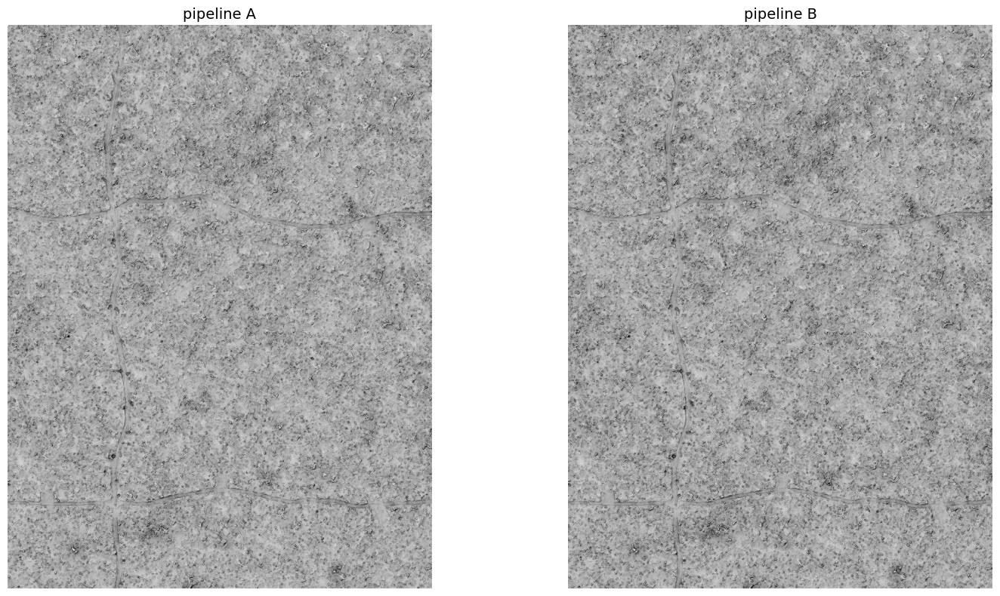

SKIP: VAT missing for BA3_A02_2014_laz_8, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/BA3_A02_2014_laz_8_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for BA3_A02_2014_laz_8, pipeline B: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/BA3_A02_2014_laz_8_fnands_openai_optimised_04_VAT_Combined.tif
SKIP: VAT missing for TAP_A01_2012_laz_2, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/TAP_A01_2012_laz_2_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for TAP_A01_2012_laz_2, pipeline B: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/TAP_A01_2012_laz_2_fnands_openai_optimised_04_VAT_Combined.tif
SKIP: VAT missing for FST_A04_2014_laz_11, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/FST_A04_2014_laz_11_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for FST_A04_2014_laz_11, pipeline B: /Users/jamesbyers/

### RIB_A01_2018_LAS_17 (density_ground_per_m2=0.075)

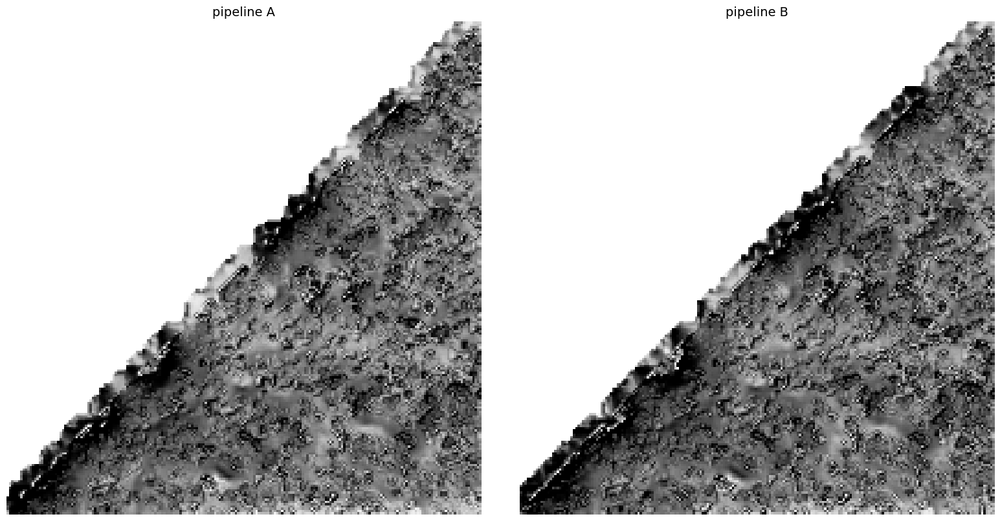

SKIP: VAT missing for FN3_A01_2014_P07_laz_6, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/FN3_A01_2014_P07_laz_6_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for FN3_A01_2014_P07_laz_6, pipeline B: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/FN3_A01_2014_P07_laz_6_fnands_openai_optimised_04_VAT_Combined.tif
SKIP: VAT missing for FST_A05_2014_laz_0, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/FST_A05_2014_laz_0_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for FST_A05_2014_laz_0, pipeline B: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/FST_A05_2014_laz_0_fnands_openai_optimised_04_VAT_Combined.tif
SKIP: VAT missing for GO1_A01_2018_LAS_58, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/GO1_A01_2018_LAS_58_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for GO1_A01_2018_LAS_58, pipeline B: /U

### JAM_A01_2011_laz_10 (density_ground_per_m2=0.432)

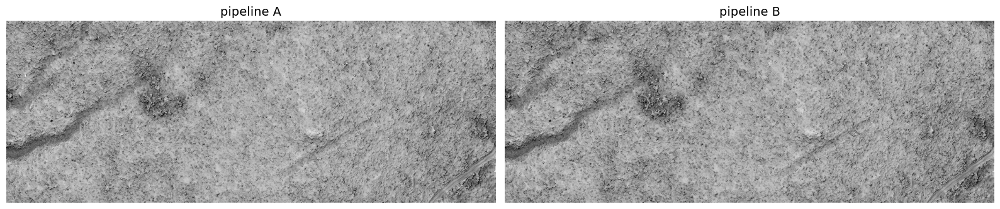

SKIP: VAT missing for AND_A01_2013_laz_optional_12, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/AND_A01_2013_laz_optional_12_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for AND_A01_2013_laz_optional_12, pipeline B: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/AND_A01_2013_laz_optional_12_fnands_openai_optimised_04_VAT_Combined.tif
SKIP: VAT missing for DUC_A01_2012_laz_18, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/DUC_A01_2012_laz_18_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for DUC_A01_2012_laz_18, pipeline B: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/DUC_A01_2012_laz_18_fnands_openai_optimised_04_VAT_Combined.tif
SKIP: VAT missing for FST_A02_2014_laz_3, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/FST_A02_2014_laz_3_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for FST_A02_2

### JAM_A05_2014_laz_8 (density_ground_per_m2=0.694)

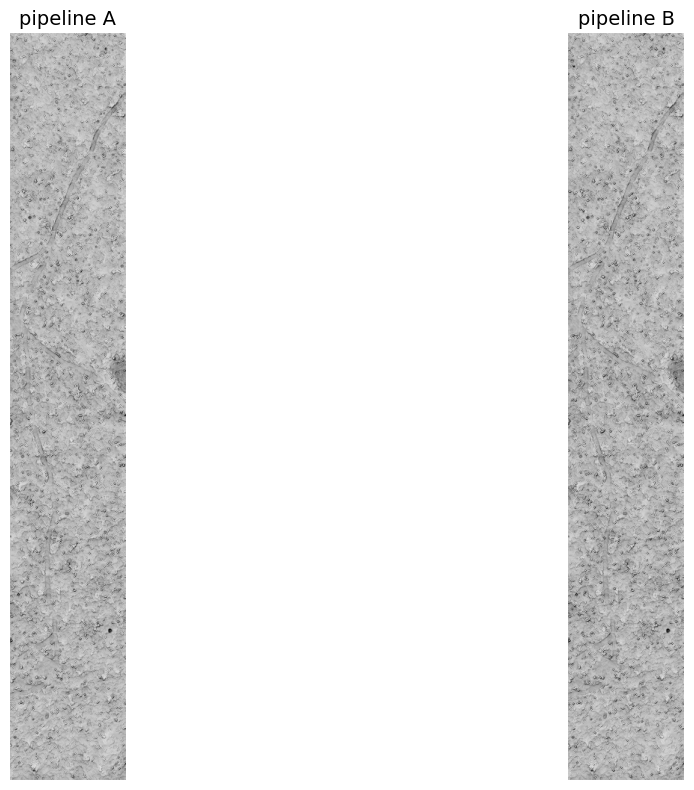

### BON_A01_2013_laz_11 (density_ground_per_m2=0.519)

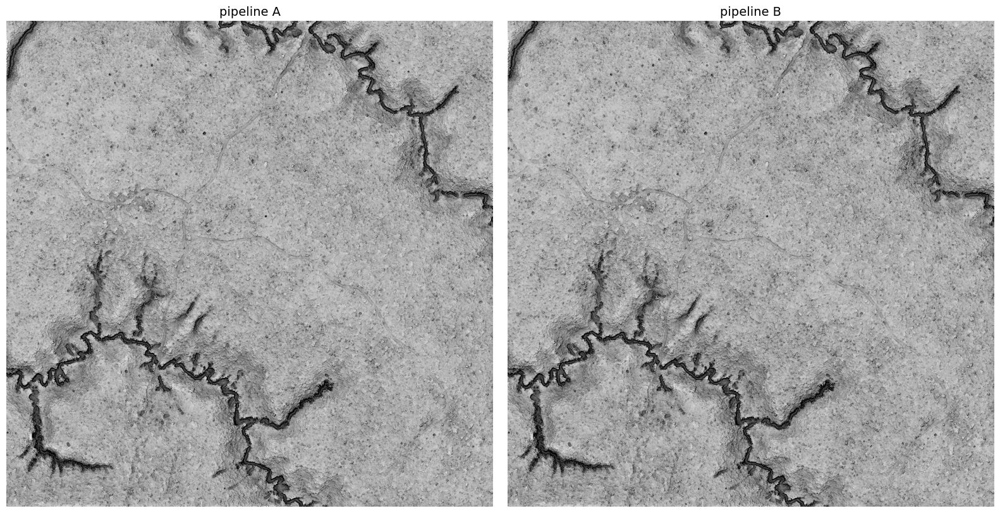

### TAL_A01_2013_laz_7 (density_ground_per_m2=0.234)

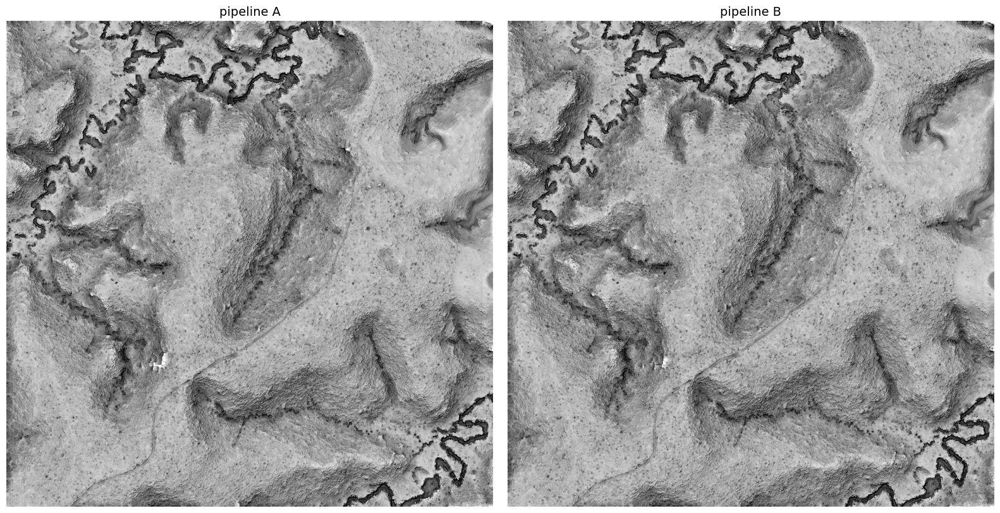

SKIP: VAT missing for SDM_A01_2012_laz_0, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/SDM_A01_2012_laz_0_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for SDM_A01_2012_laz_0, pipeline B: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/SDM_A01_2012_laz_0_fnands_openai_optimised_04_VAT_Combined.tif
SKIP: VAT missing for FNA_A01_2018_LAS_5, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/FNA_A01_2018_LAS_5_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for FNA_A01_2018_LAS_5, pipeline B: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/FNA_A01_2018_LAS_5_fnands_openai_optimised_04_VAT_Combined.tif
SKIP: VAT missing for FST_A06_2015_laz_1, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/FST_A06_2015_laz_1_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for FST_A06_2015_laz_1, pipeline B: /Users/jamesbyers/cod

### ANTL5780C8970_cleaned (density_ground_per_m2=0.403)

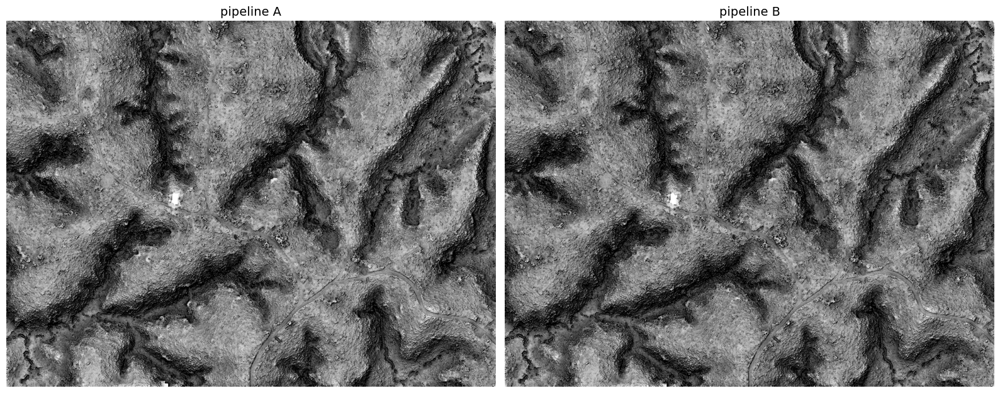

SKIP: VAT missing for PAR_A01_2013_laz_9, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/PAR_A01_2013_laz_9_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for PAR_A01_2013_laz_9, pipeline B: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/PAR_A01_2013_laz_9_fnands_openai_optimised_04_VAT_Combined.tif


### HUM_A01_2018_LAS_9 (density_ground_per_m2=0.222)

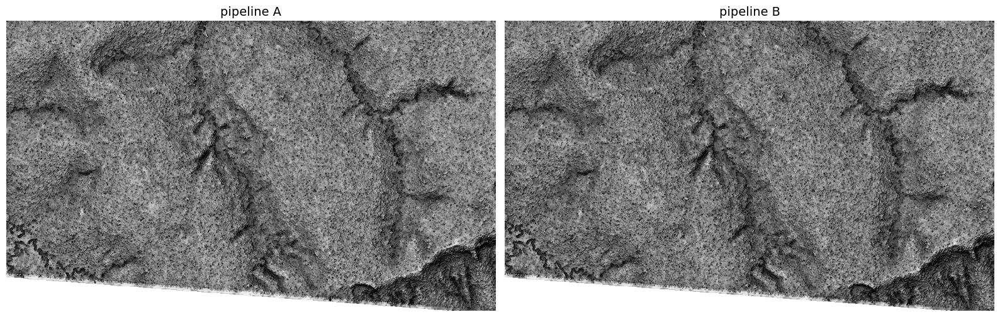

SKIP: VAT missing for SFX_A02_2012_laz_18, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/SFX_A02_2012_laz_18_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for SFX_A02_2012_laz_18, pipeline B: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/SFX_A02_2012_laz_18_fnands_openai_optimised_04_VAT_Combined.tif


### ANTL5800C8970_cleaned (density_ground_per_m2=0.421)

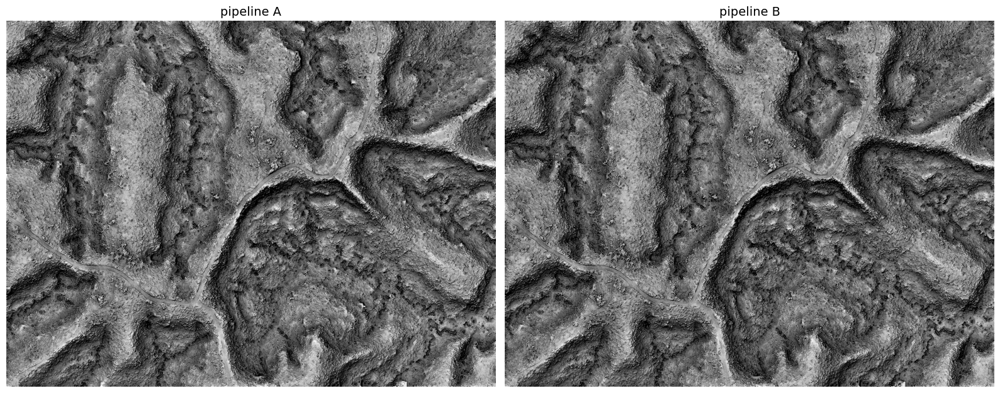

SKIP: VAT missing for FND_A02_2017_laz_2, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/FND_A02_2017_laz_2_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for FND_A02_2017_laz_2, pipeline B: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/FND_A02_2017_laz_2_fnands_openai_optimised_04_VAT_Combined.tif


### JAM_A03_2014_laz_9 (density_ground_per_m2=0.908)

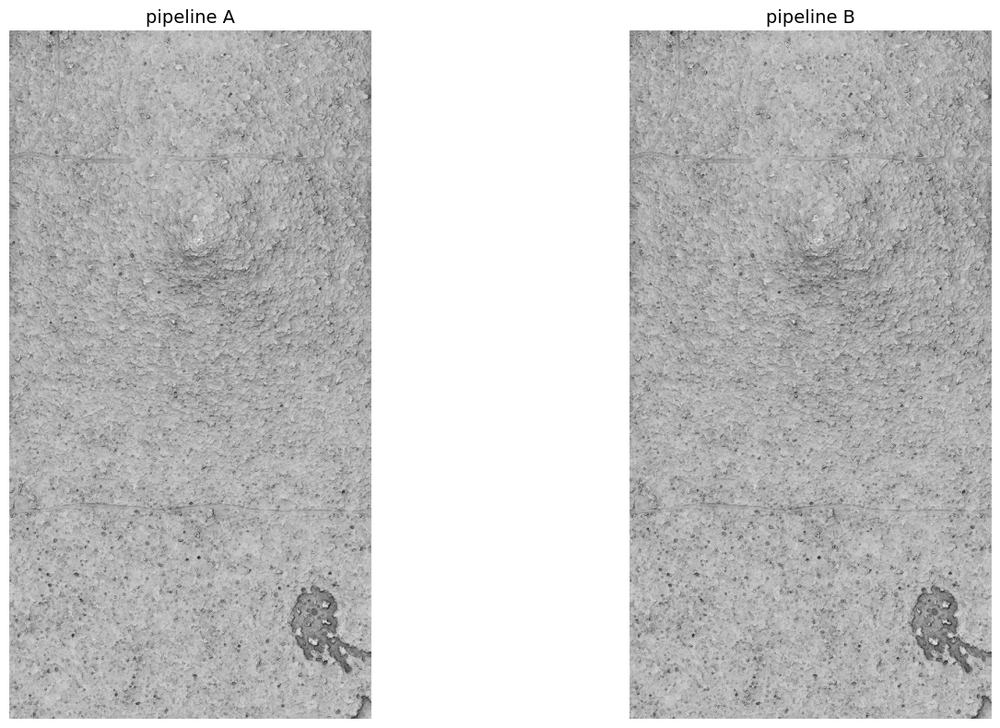

### ANTL5770C8971_cleaned (density_ground_per_m2=0.403)

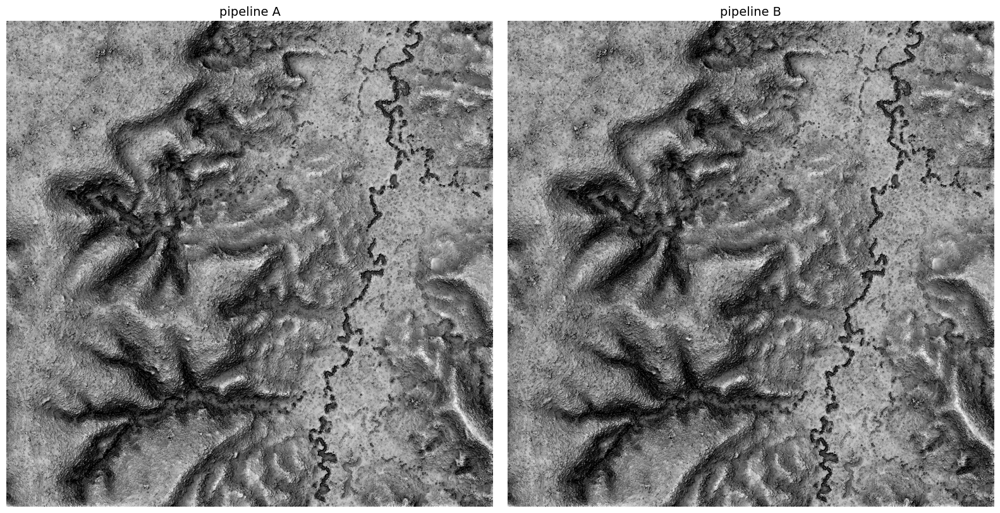

### ANTL5790C8970_cleaned (density_ground_per_m2=0.440)

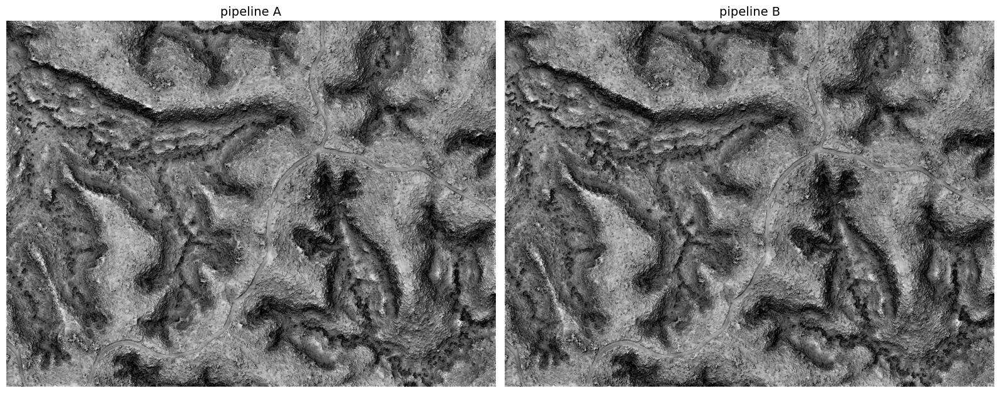

SKIP: VAT missing for TAC_A01_2013_laz_8, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/TAC_A01_2013_laz_8_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for TAC_A01_2013_laz_8, pipeline B: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/TAC_A01_2013_laz_8_fnands_openai_optimised_04_VAT_Combined.tif
SKIP: VAT missing for CAN_A01_2014_laz_0, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/CAN_A01_2014_laz_0_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for CAN_A01_2014_laz_0, pipeline B: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/CAN_A01_2014_laz_0_fnands_openai_optimised_04_VAT_Combined.tif
SKIP: VAT missing for SAN_A02_2014_laz_4, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/SAN_A02_2014_laz_4_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for SAN_A02_2014_laz_4, pipeline B: /Users/jamesbyers/cod

### ANT_A01_2011_laz_6 (density_ground_per_m2=0.495)

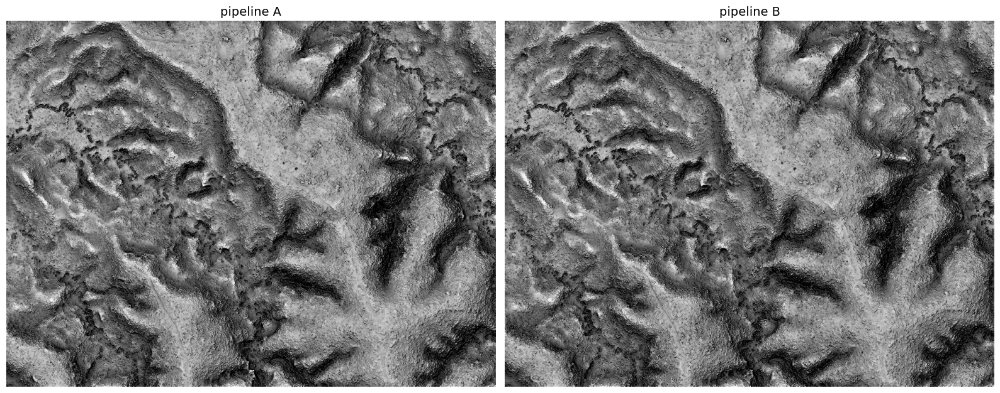

### JAM_A06_2014_laz_8 (density_ground_per_m2=0.757)

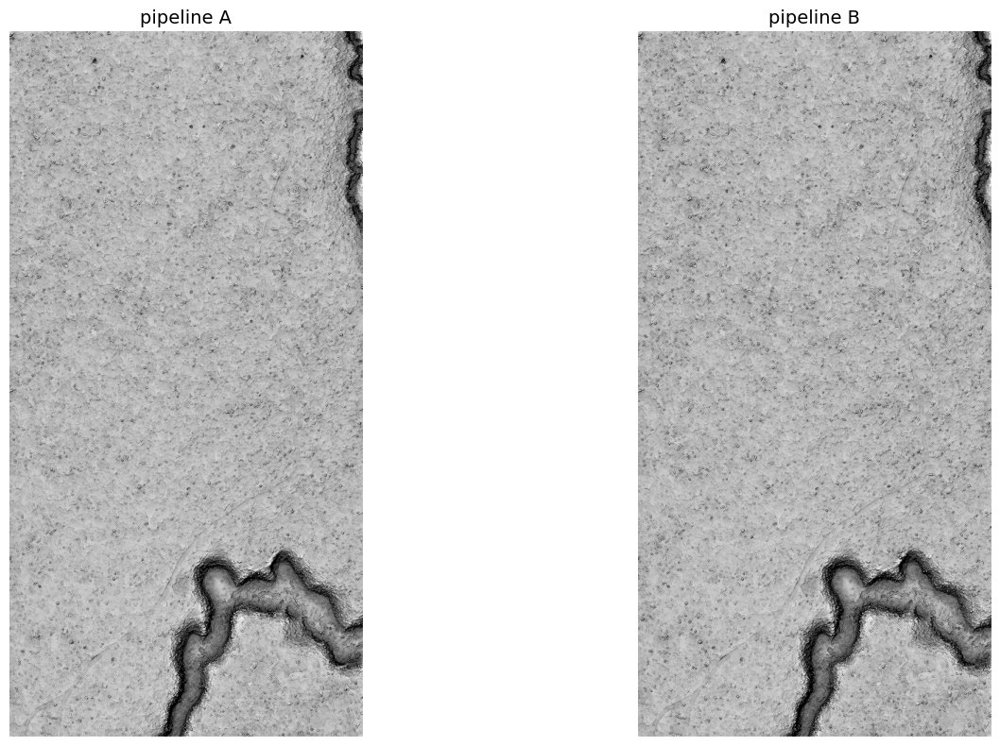

SKIP: VAT missing for TAP_A06_2008_17-01, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/TAP_A06_2008_17-01_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for TAP_A06_2008_17-01, pipeline B: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/TAP_A06_2008_17-01_fnands_openai_optimised_04_VAT_Combined.tif


### JAC_A03_2015_laz_2 (density_ground_per_m2=0.331)

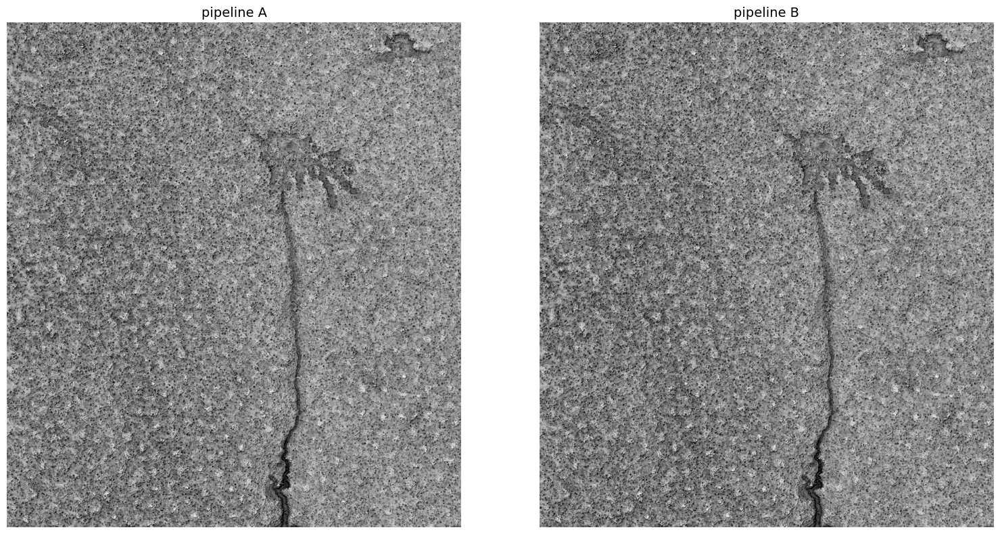

### JAC_A04_2015_laz_1 (density_ground_per_m2=0.490)

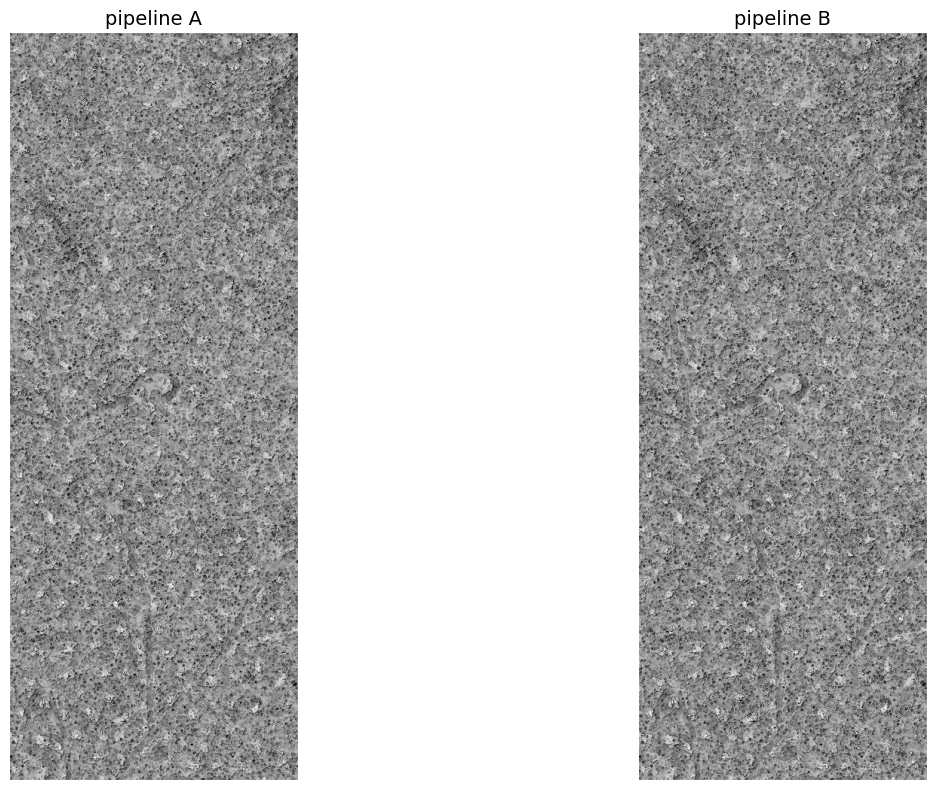

SKIP: VAT missing for FNC_A04_2017_laz_1, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/FNC_A04_2017_laz_1_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for FNC_A04_2017_laz_1, pipeline B: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/FNC_A04_2017_laz_1_fnands_openai_optimised_04_VAT_Combined.tif
SKIP: VAT missing for FNC_A03_2017_laz_2, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/FNC_A03_2017_laz_2_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for FNC_A03_2017_laz_2, pipeline B: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/FNC_A03_2017_laz_2_fnands_openai_optimised_04_VAT_Combined.tif


### JAC_A05_2015_laz_5 (density_ground_per_m2=0.408)

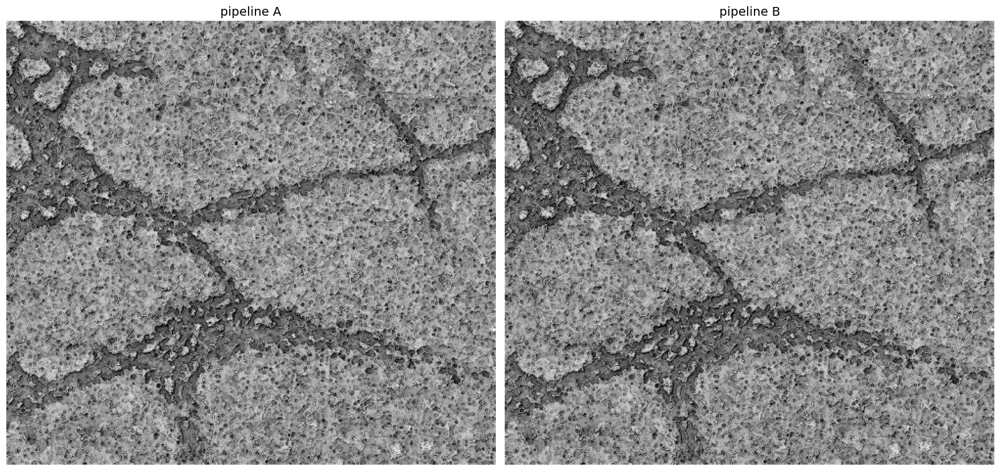

### JAC_A02_2015_laz_5 (density_ground_per_m2=0.377)

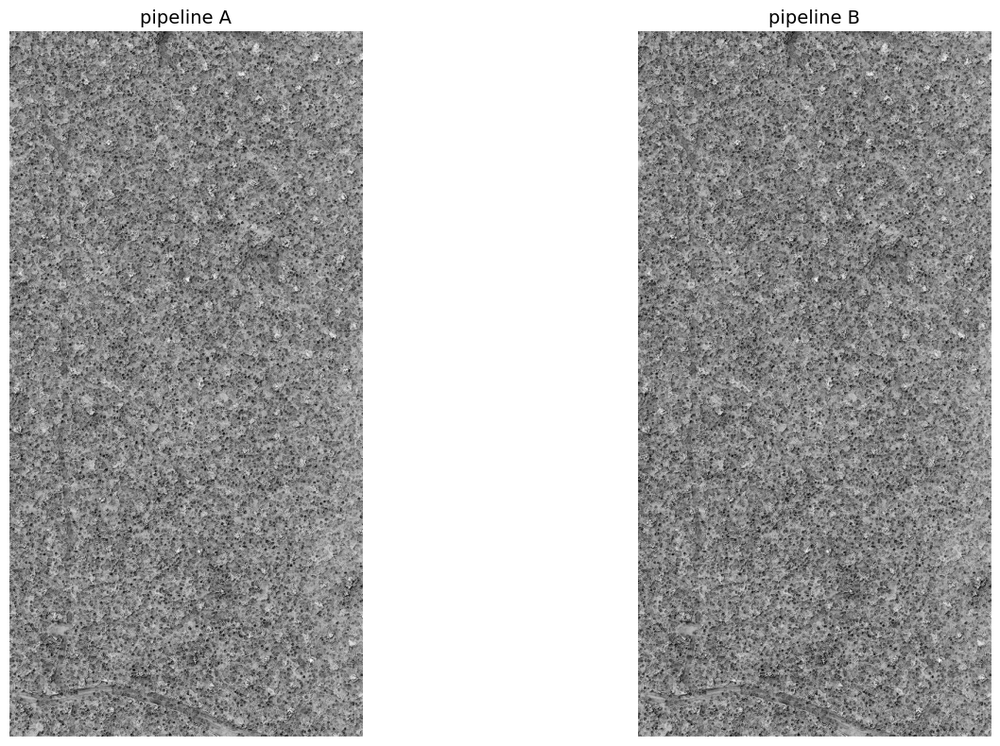

SKIP: VAT missing for TAP_A05_2008_laz_0, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/TAP_A05_2008_laz_0_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for TAP_A05_2008_laz_0, pipeline B: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/TAP_A05_2008_laz_0_fnands_openai_optimised_04_VAT_Combined.tif
SKIP: VAT missing for cms_brazil_lidar_tile_inventory, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/cms_brazil_lidar_tile_inventory_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for cms_brazil_lidar_tile_inventory, pipeline B: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/cms_brazil_lidar_tile_inventory_fnands_openai_optimised_04_VAT_Combined.tif


### JAM_A04_2014_laz_5 (density_ground_per_m2=0.935)

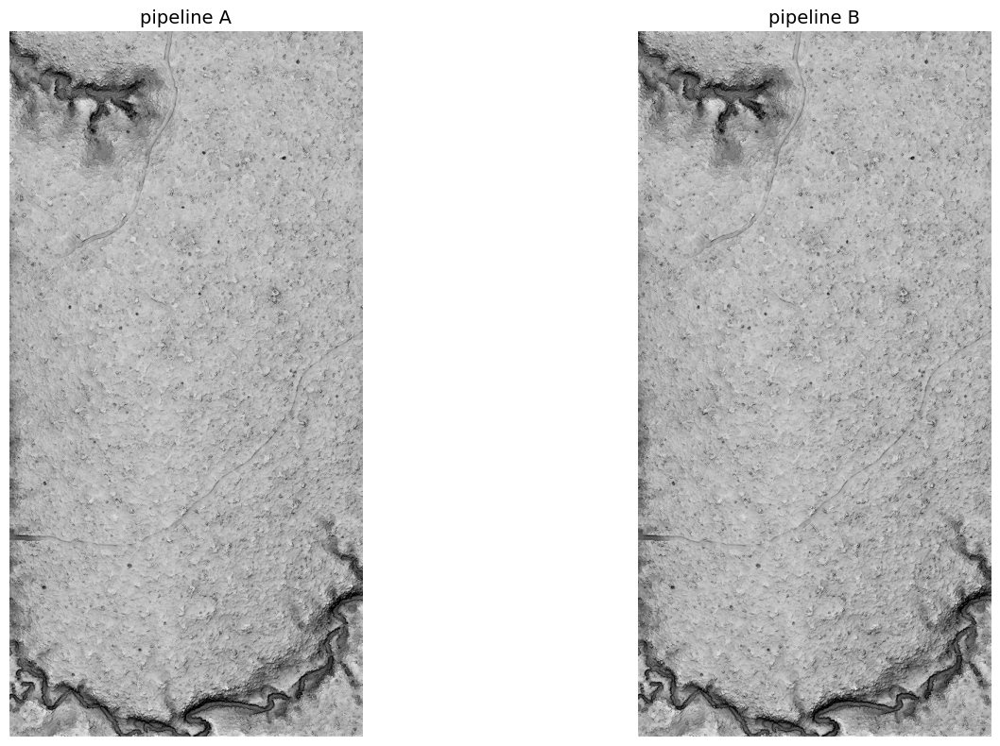

### JAM_A07_2015_laz_4 (density_ground_per_m2=0.375)

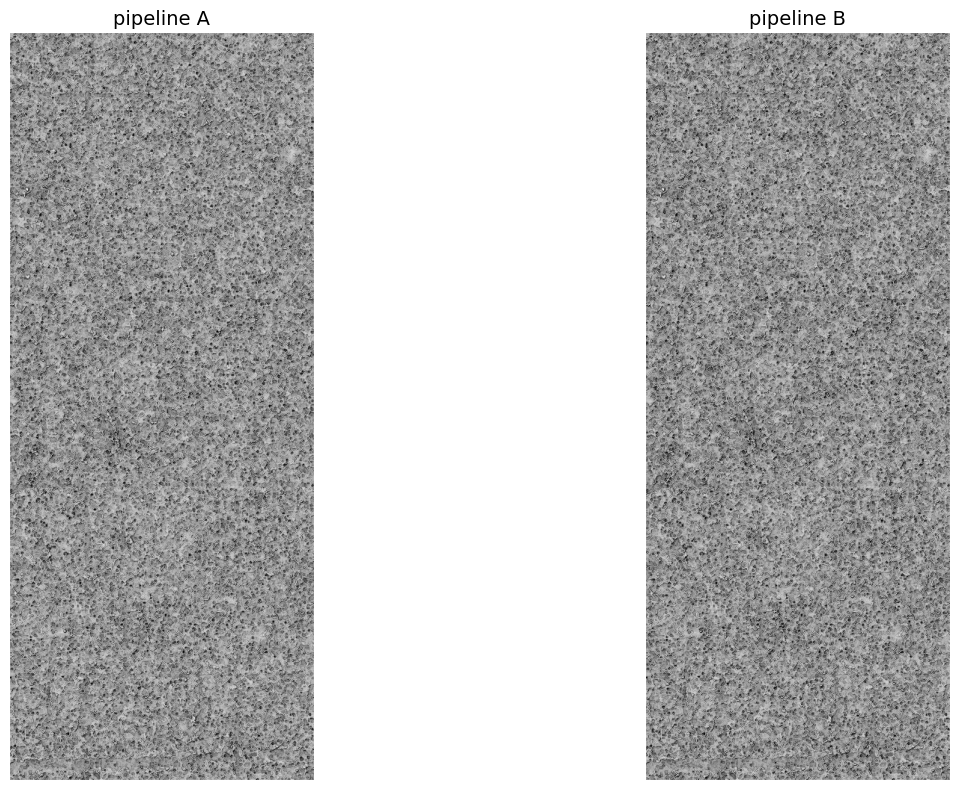

### JAC_A01_2015_laz_7 (density_ground_per_m2=0.382)

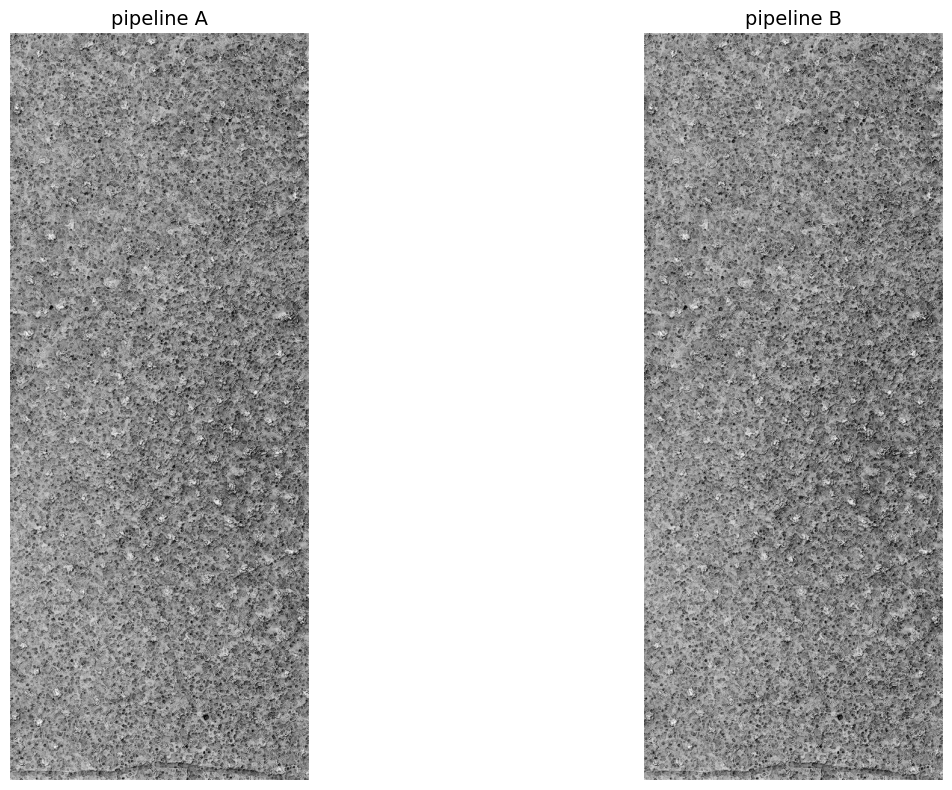

### JAM_A08_2015_laz_4 (density_ground_per_m2=0.412)

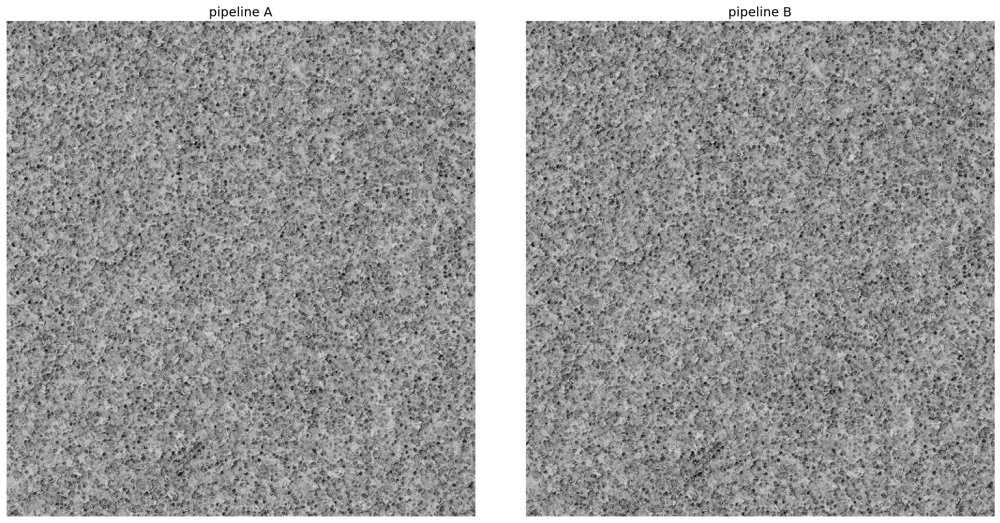

SKIP: VAT missing for FND_A01_2017_las_4, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/FND_A01_2017_las_4_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for FND_A01_2017_las_4, pipeline B: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/FND_A01_2017_las_4_fnands_openai_optimised_04_VAT_Combined.tif
SKIP: VAT missing for FNC_A01_2017_laz_1, pipeline A: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/FNC_A01_2017_laz_1_fnands_openai_optimised_02_VAT_Combined.tif
SKIP: VAT missing for FNC_A01_2017_laz_1, pipeline B: /Users/jamesbyers/code/github/Kaggle/openai_to_z/data/processed/VAT/FNC_A01_2017_laz_1_fnands_openai_optimised_04_VAT_Combined.tif


In [16]:
# Block 5B: Visualise all VAT pairs, one cell per pair

from IPython.display import display, Markdown

for fname in laz_basenames:
    # Prep VAT paths
    vat_files = {}
    show = True
    for label, suffix in PIPELINE_SUFFIX.items():
        dtm_fname = f"{fname}{suffix}"
        vat_fname = dtm_fname.replace('.tif', '_VAT_Combined.tif')
        vat_path = os.path.join(VAT_DIR, vat_fname)
        vat_files[label] = vat_path
        if not os.path.isfile(vat_path):
            print(f"SKIP: VAT missing for {fname}, pipeline {label}: {vat_path}")
            show = False
    if not show:
        continue

    # Read VATs
    try:
        vat_a = read_vat_float_image(vat_files["A"])
        vat_b = read_vat_float_image(vat_files["B"])
    except Exception as e:
        print(f"Error reading VATs for {fname}: {e}")
        continue

    g_density = all_ground_densities.get(fname, None)
    if g_density is None or np.isnan(g_density):
        dens_str = "N/A"
    else:
        dens_str = f"{g_density:.3f}"

    # Display with Markdown above for readability
    display(Markdown(f"### {fname} (density_ground_per_m2={dens_str})"))
    # Optionally, you could use plt.figure() per cell, for scrollable review
    fig, axes = plt.subplots(1, 2, figsize=(16, 8))
    vmin = np.nanmin([vat_a, vat_b])
    vmax = np.nanmax([vat_a, vat_b])
    axes[0].imshow(vat_a, cmap='gray', vmin=vmin, vmax=vmax)
    axes[0].set_title(f"pipeline A", fontsize=14)
    axes[0].axis('off')
    axes[1].imshow(vat_b, cmap='gray', vmin=vmin, vmax=vmax)
    axes[1].set_title(f"pipeline B", fontsize=14)
    axes[1].axis('off')
    plt.tight_layout()
    plt.show()

## FILES OF INTEREST